In [130]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor='white', frameon=True, fontsize=20, figsize=(12, 12))

palette_8 = {
    'Cancer Stem Cells': '#2ca02c',
    'Endothelial': '#d62728',
    'Astrocyte': '#9467bd',
    'OPC-like': '#8c564b',
    'NPC-like': '#e377c2',
    'Progenitor': '#7f7f7f',
    'Mesenchymal': '#ff7f9e',
}

mes_like = ["ENO2", "HILPDA", "ANXA1", "ANXA2"]
ac_like = ["CST3", "S100B", "MLC1"]
opc_like = ["OMG", "PLLP"]
npc_like = ["SOX4", "RND3", "SOX11"]
endothelial = ["PECAM1"]
stem = ["SOX2","NES"]


scanpy==1.9.2 anndata==0.8.0 umap==0.5.3 numpy==1.22.0 scipy==1.10.0 pandas==1.3.5 scikit-learn==1.2.1 statsmodels==0.13.5 python-igraph==0.10.4 louvain==0.8.0 pynndescent==0.5.8


In [131]:
adata = sc.read('write/human_no_1914_final.h5ad')
sc.pp.log1p(adata)
# redo neighbors and umap
sc.pp.neighbors(adata, n_pcs=13, n_neighbors=10)

computing neighbors
    using 'X_pca' with n_pcs = 13
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [132]:
# do pca
sc.tl.pca(adata, svd_solver='arpack', n_comps=13)

computing PCA
    with n_comps=13
    finished (0:00:15)


/Users/shaunregenbaum/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


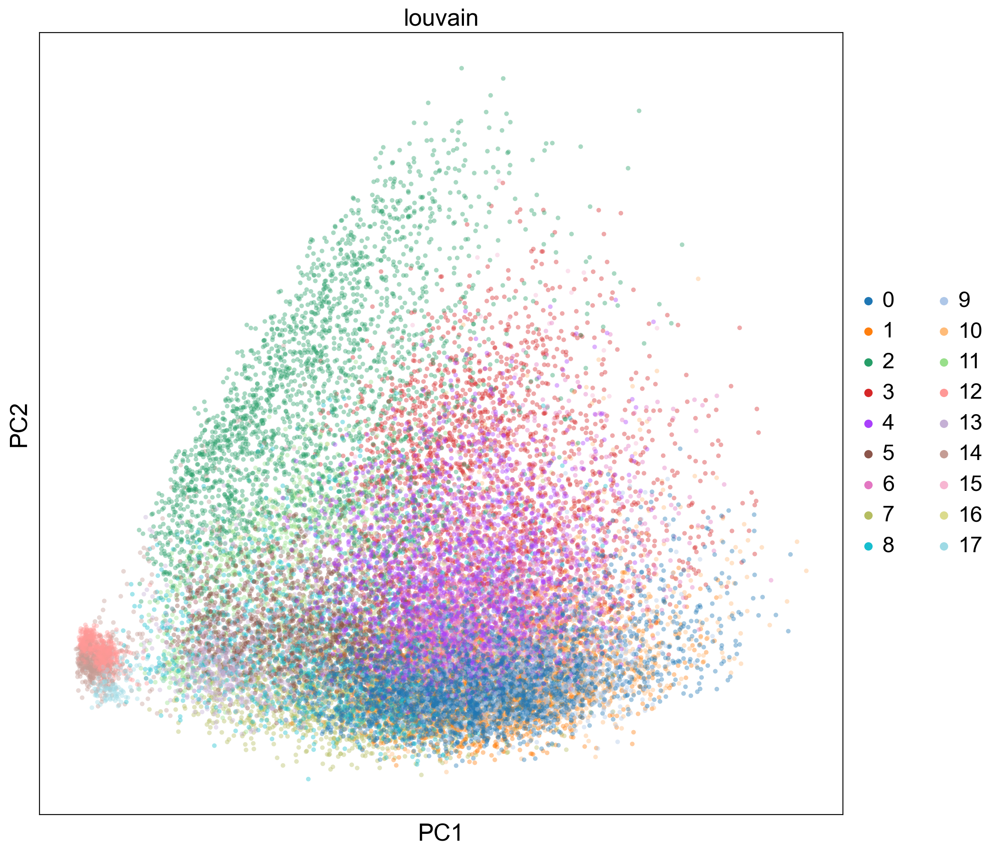

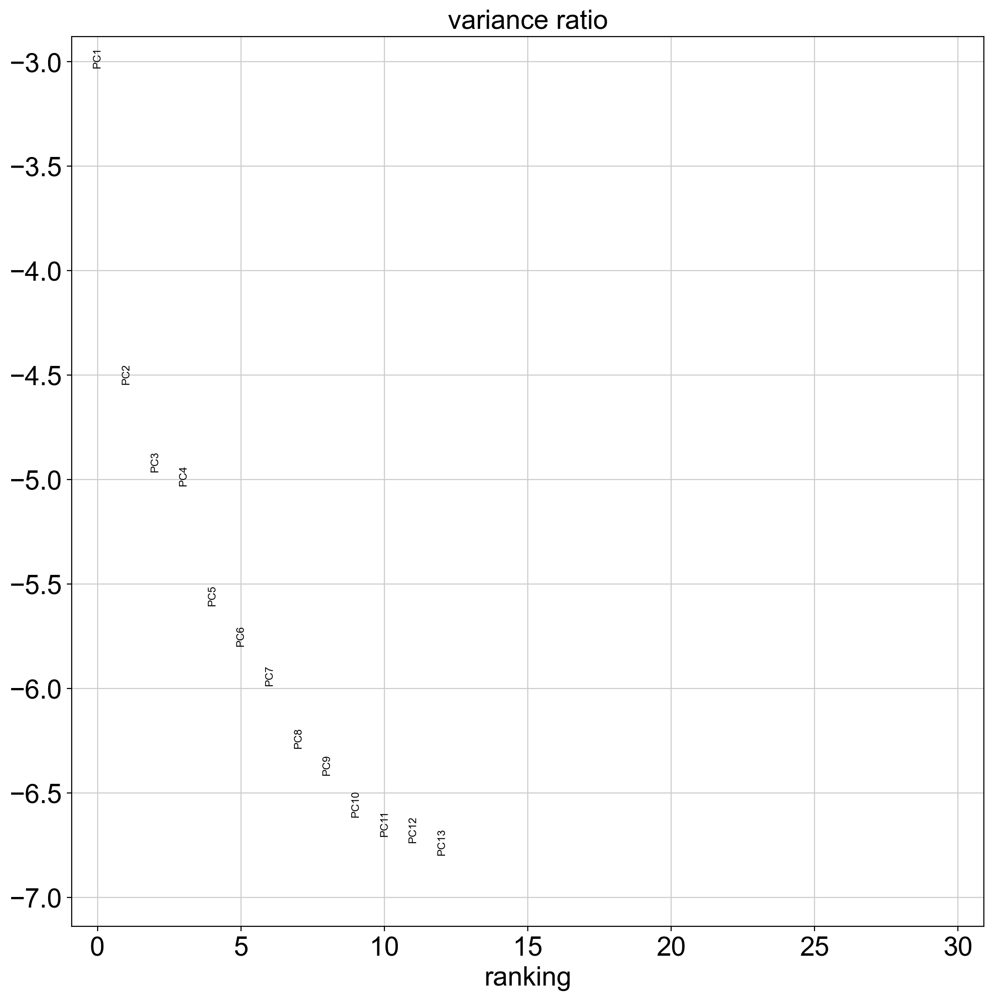

In [133]:
# pca 
sc.pl.pca(adata, color='louvain', size=60, alpha=0.4)
sc.pl.pca_variance_ratio(adata, log=True)

In [134]:
sc.pp.neighbors(adata, n_pcs=11, n_neighbors=10)
sc.tl.umap(adata, min_dist=0.18, spread=0.15)



computing neighbors
    using 'X_pca' with n_pcs = 11
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 22 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:01)


/Users/shaunregenbaum/miniconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


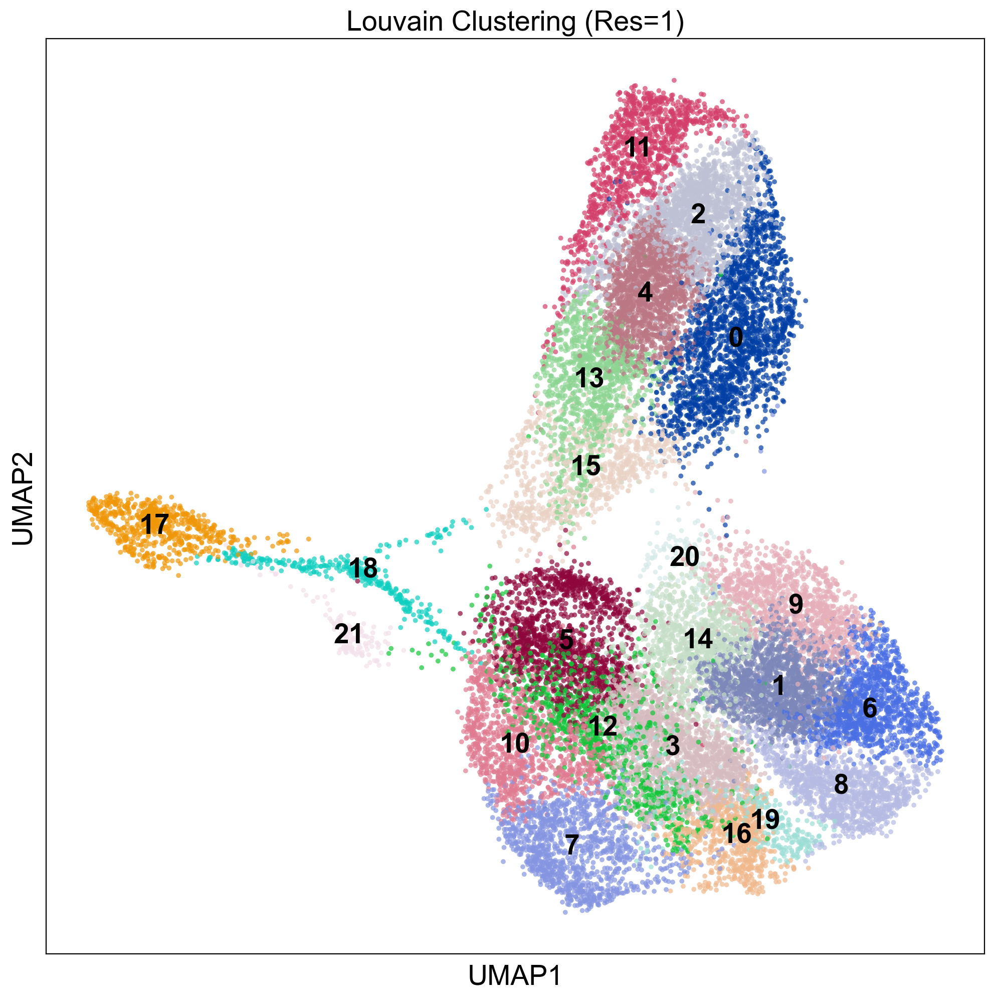

In [135]:
# redo louvain clustering
sc.tl.louvain(adata, resolution=1)
adata.obs
sc.pl.umap(adata, color="louvain", size=50, alpha=0.7, legend_loc="on data", title="Louvain Clustering (Res=1)", save='/louvain.png')


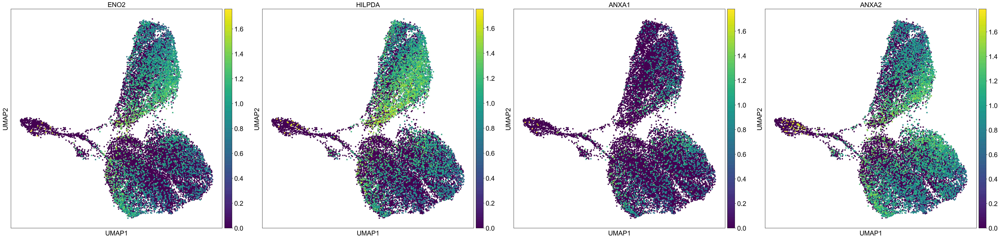

In [136]:
sc.pl.umap(adata, color=mes_like, size=70, save='/mes_individual.png')
# add up the expression of mes_like genes and put it in adata.var
data = adata[:, mes_like].X.toarray()
mes_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(mes_expression=pd.Series(mes_expression, index=adata.obs.index))



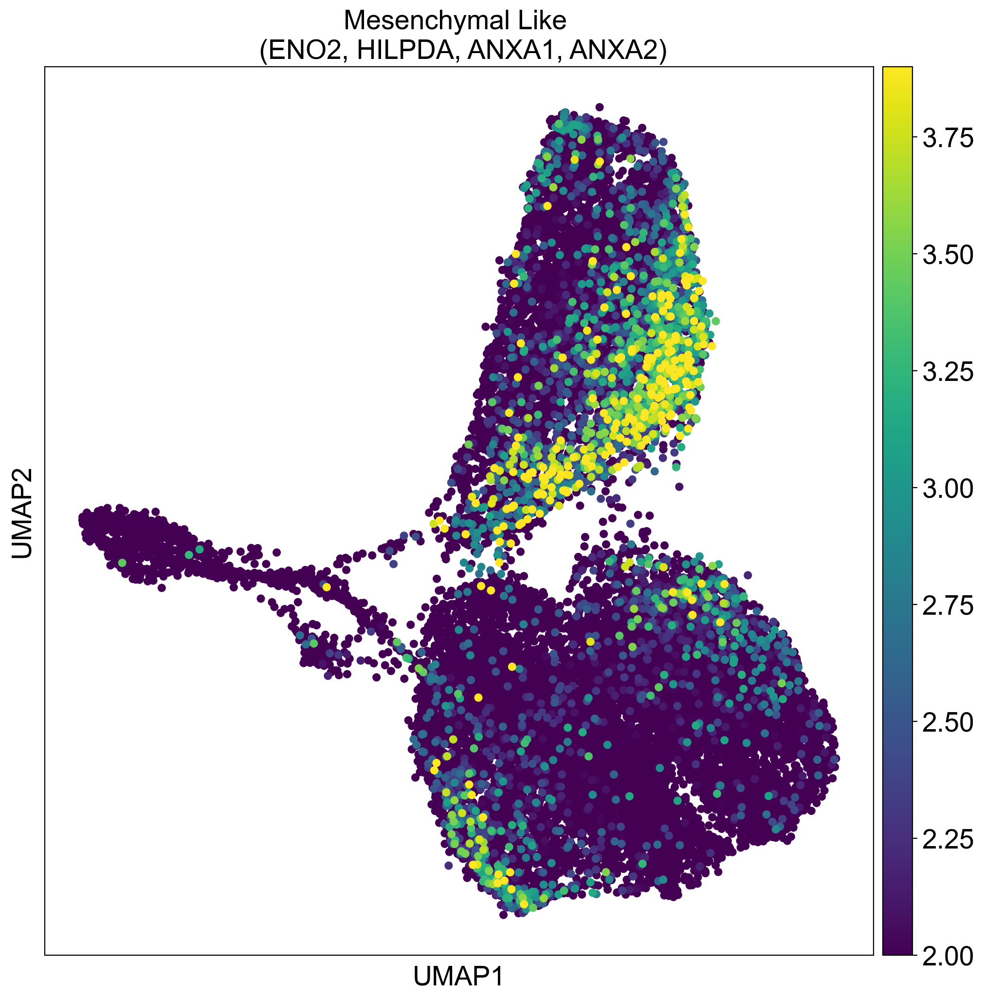

In [137]:
sc.pl.umap(adata, color='mes_expression', vmin=2.0, vmax=3.9, title='Mesenchymal Like \n (ENO2, HILPDA, ANXA1, ANXA2)', size=150, save='/mesenchymal.png')


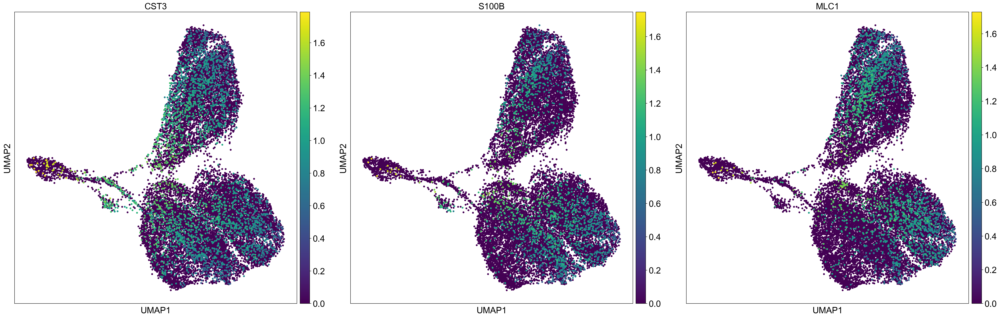

In [138]:
sc.pl.umap(adata, color=ac_like, size=70, save='/ac_individual.png'  )
# add up the expression of mes_like genes and put it in adata.var
data = adata[:, ac_like].X.toarray()
ac_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(ac_expression=pd.Series(ac_expression, index=adata.obs.index))



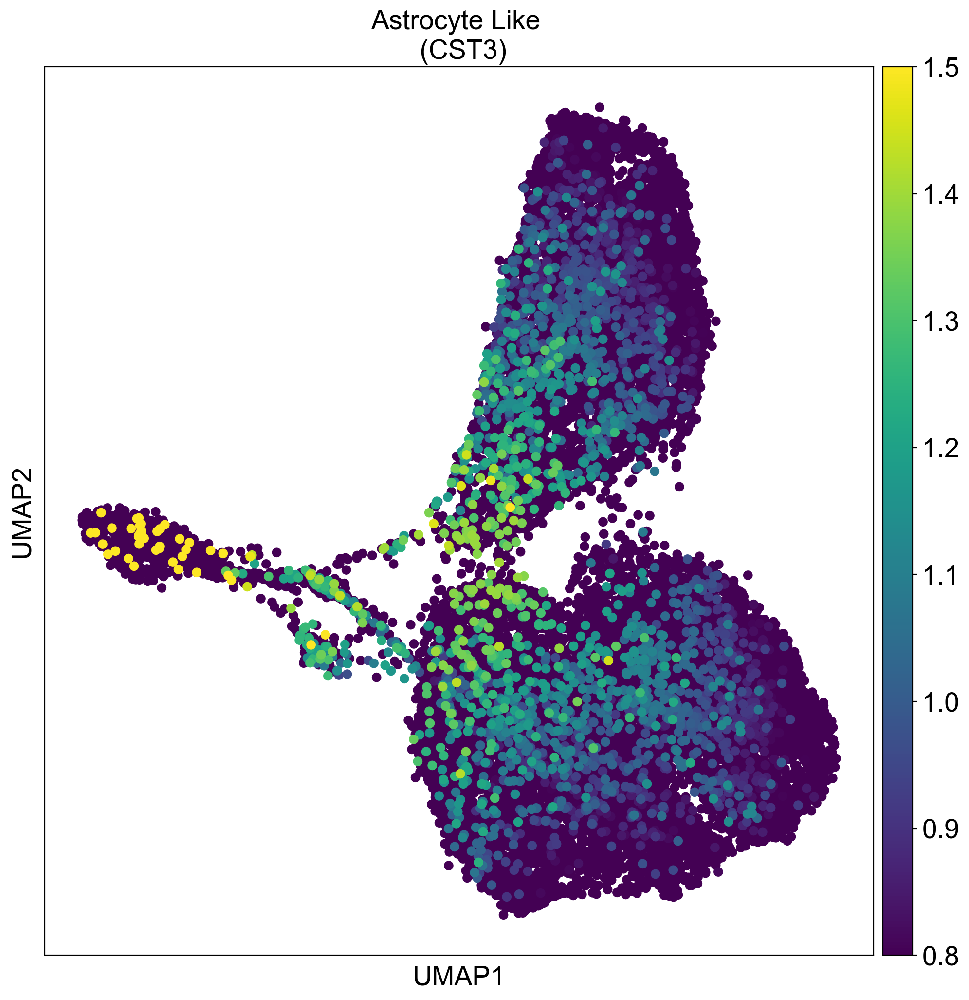

In [139]:
sc.pl.umap(adata, color=['CST3'], vmax=1.5, vmin=0.8, title='Astrocyte Like \n (CST3)', size=200, save='/astrocyte.png')

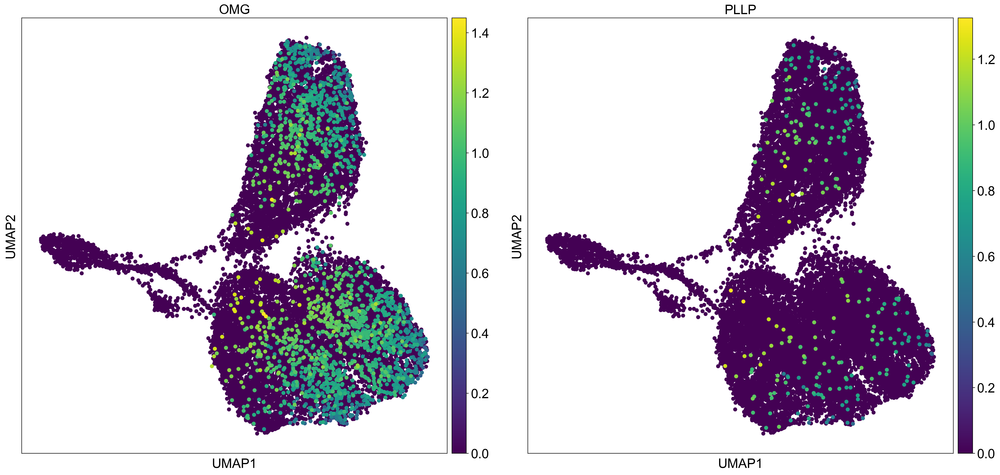

In [140]:
sc.pl.umap(adata, color=opc_like, size=150, save='/opc_individual.png')
# add up the expression of mes_like genes and put it in adata.var
data = adata[:, opc_like].X.toarray()
opc_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(opc_expression=pd.Series(opc_expression, index=adata.obs.index))



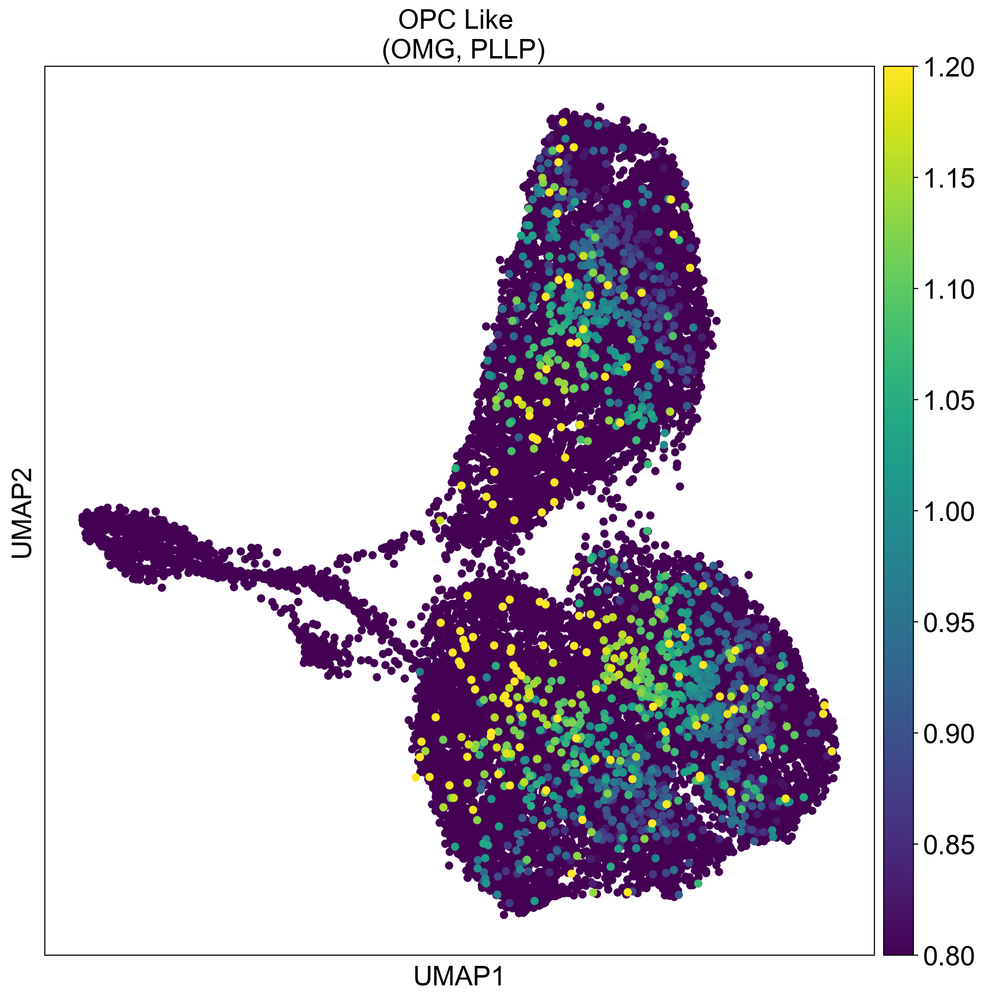

In [141]:
sc.pl.umap(adata, color='opc_expression', vmax=1.2, vmin=0.8, title='OPC Like \n (OMG, PLLP)', size=150, save='/opc.png')

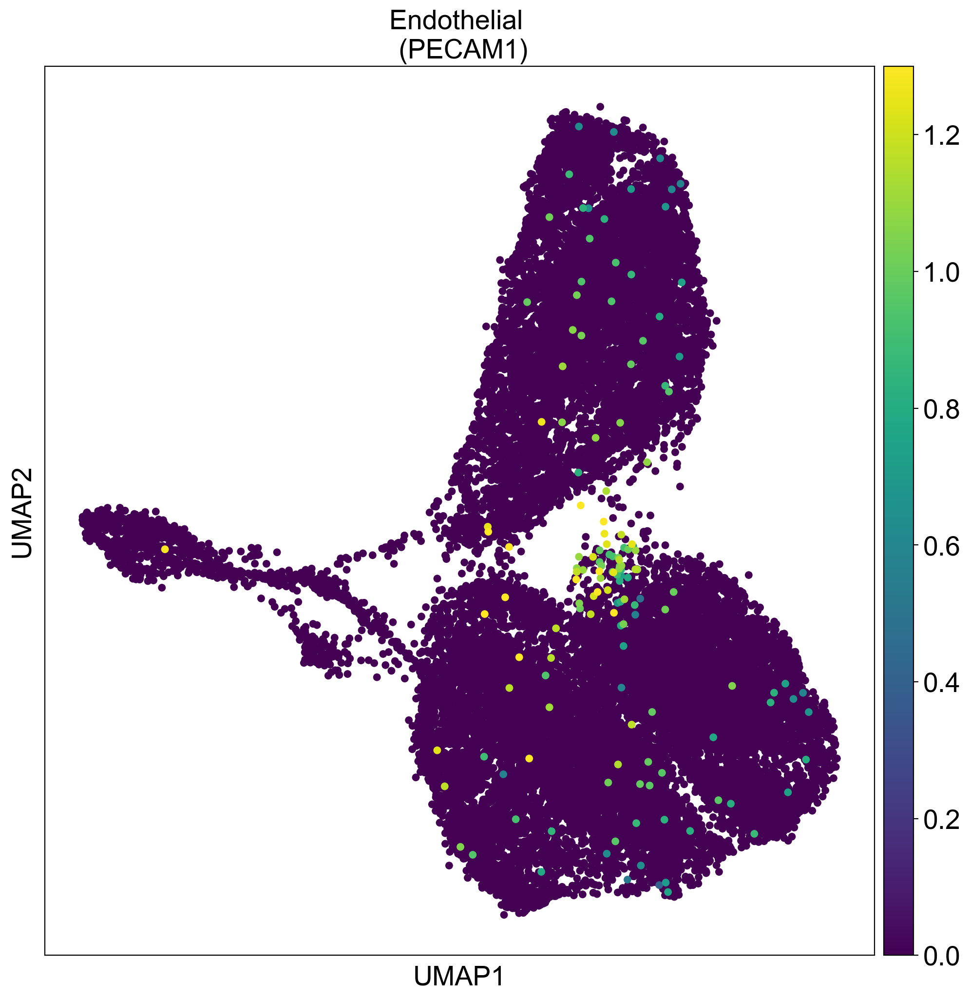

In [142]:
sc.pl.umap(adata, color=endothelial, title="Endothelial \n (PECAM1)", vmax=1.3, size=130, save='/endothelial.png')

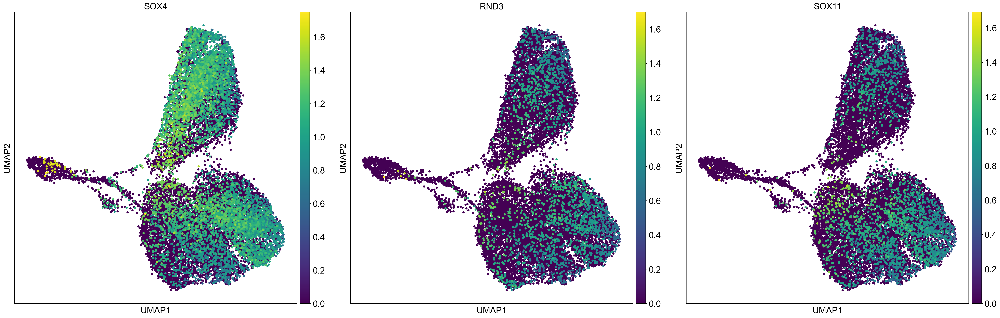

In [143]:
sc.pl.umap(adata, color=npc_like, size=100, save='/npc_individual.png')

data = adata[:, npc_like].X.toarray()
npc_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(npc_expression=pd.Series(npc_expression, index=adata.obs.index))


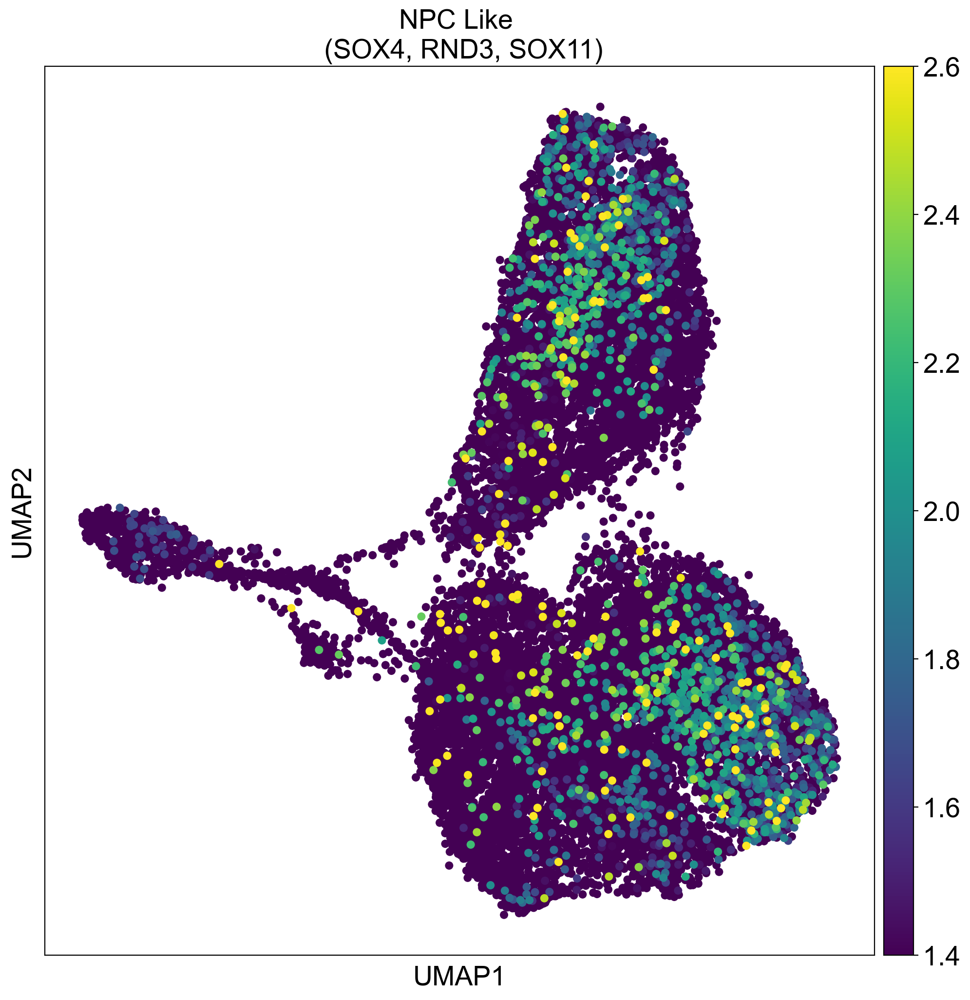

In [144]:
sc.pl.umap(adata, color='npc_expression',vmin=1.4,vmax=2.6, size=150, title='NPC Like \n (SOX4, RND3, SOX11)', save='/npc.png')

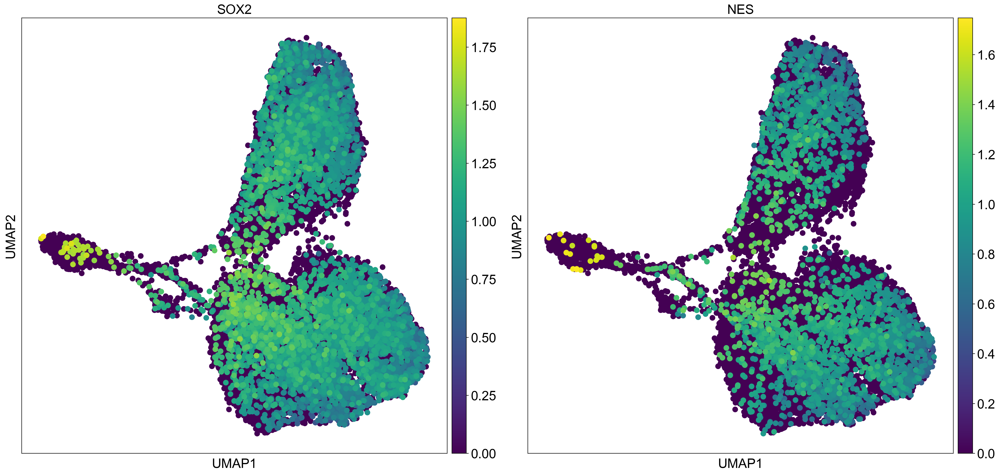

In [145]:
sc.pl.umap(adata, color=stem, size=300)

# add up the expression of mes_like genes and put it in adata.var
data = adata[:, stem].X.toarray()
stem_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(stem_expression=pd.Series(stem_expression, index=adata.obs.index))



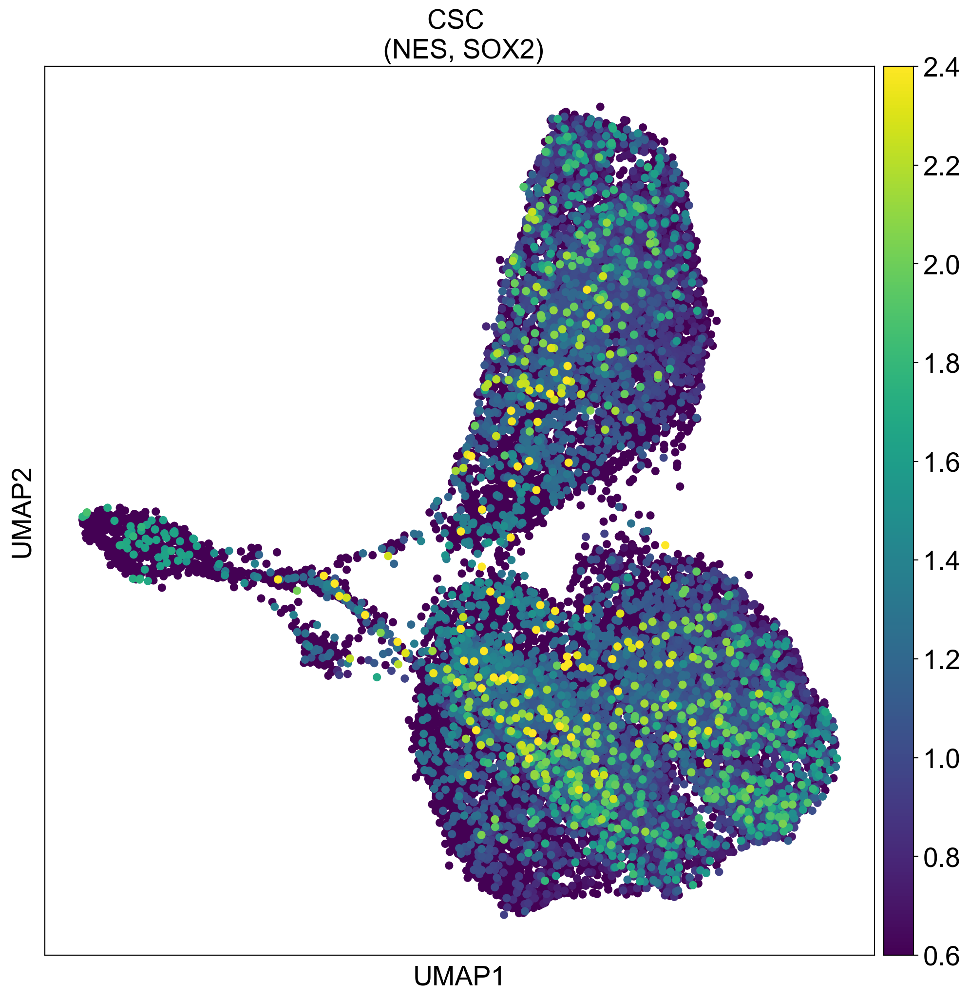

In [146]:
sc.pl.umap(adata, color='stem_expression',vmin=0.6, vmax=2.4, title="CSC \n (NES, SOX2)", size=150, save='/stem.png')

In [165]:
# drop cell_type_f
adata.obs = adata.obs.drop(columns=['cell_type_f'])
# Annotating types
adata.obs.loc[adata.obs.louvain == '0', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.louvain == '9', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.louvain == '7', 'cell_type_f'] = 'Mesenchymal'


adata.obs.loc[adata.obs.louvain == '17', 'cell_type_f'] = 'Astrocyte'
adata.obs.loc[adata.obs.louvain == '21', 'cell_type_f'] = 'Astrocyte'
adata.obs.loc[adata.obs.louvain == '10', 'cell_type_f'] = 'Astrocyte'
adata.obs.loc[adata.obs.louvain == '5', 'cell_type_f'] = 'Astrocyte'
adata.obs.loc[adata.obs.louvain == '15', 'cell_type_f'] = 'Astrocyte'
adata.obs.loc[adata.obs.louvain == '18', 'cell_type_f'] = 'Astrocyte'




adata.obs.loc[adata.obs.louvain == '4', 'cell_type_f'] = 'Progenitor'
adata.obs.loc[adata.obs.louvain == '2', 'cell_type_f'] = 'Progenitor'
adata.obs.loc[adata.obs.louvain == '11', 'cell_type_f'] = 'Progenitor'
adata.obs.loc[adata.obs.louvain == '6', 'cell_type_f'] = 'Progenitor'
adata.obs.loc[adata.obs.louvain == '8', 'cell_type_f'] = 'Progenitor'
adata.obs.loc[adata.obs.louvain == '1', 'cell_type_f'] = 'Progenitor'
adata.obs.loc[adata.obs.louvain == '14', 'cell_type_f'] = 'Progenitor'

adata.obs.loc[adata.obs.louvain == '4', 'cell_type_f'] = 'OPC'
adata.obs.loc[adata.obs.louvain == '14', 'cell_type_f'] = 'OPC'
adata.obs.loc[adata.obs.louvain == '1', 'cell_type_f'] = 'OPC'


adata.obs.loc[adata.obs.louvain == '2', 'cell_type_f'] = 'NPC'
adata.obs.loc[adata.obs.louvain == '11', 'cell_type_f'] = 'NPC'
adata.obs.loc[adata.obs.louvain == '8', 'cell_type_f'] = 'NPC'
adata.obs.loc[adata.obs.louvain == '6', 'cell_type_f'] = 'NPC'


adata.obs.loc[adata.obs.louvain == '13', 'cell_type_f'] ='Cancer Stem Cell' 
adata.obs.loc[adata.obs.louvain == '12', 'cell_type_f'] ='Cancer Stem Cell' 
adata.obs.loc[adata.obs.louvain == '3', 'cell_type_f'] ='Cancer Stem Cell' 
adata.obs.loc[adata.obs.louvain == '19', 'cell_type_f'] = 'Cancer Stem Cell'
adata.obs.loc[adata.obs.louvain == '16', 'cell_type_f'] = 'Cancer Stem Cell'


adata.obs.loc[adata.obs.louvain == '20', 'cell_type_f'] = 'Endothelial'



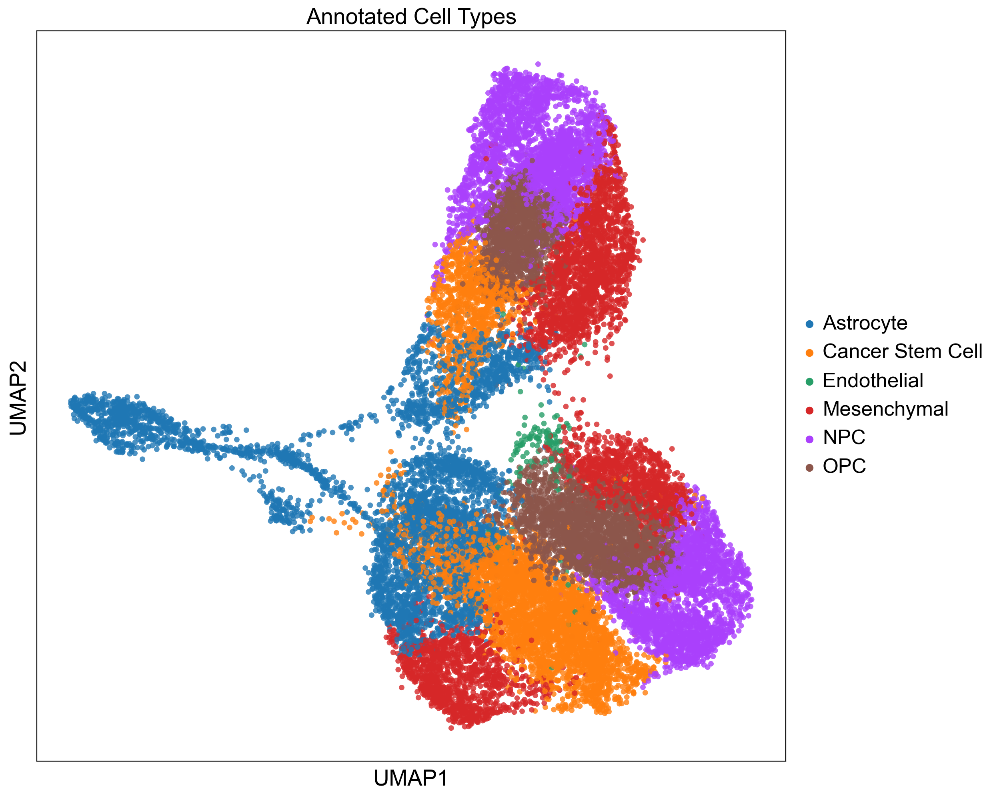

In [166]:
# add opacity
sc.pl.umap(adata, color="cell_type_f", title="Annotated Cell Types", size=100, alpha=0.8, save='/annotated_final.png')

<AxesSubplot: title={'center': 'Ours'}>

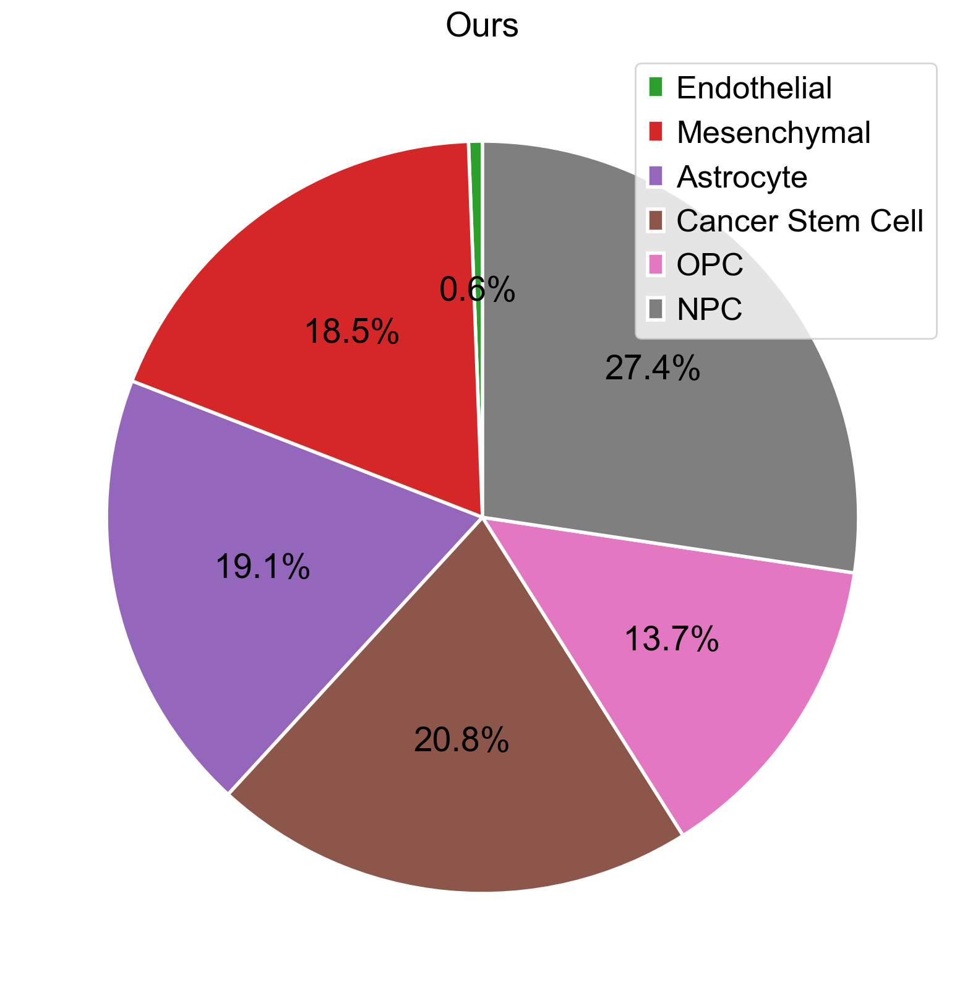

In [160]:

# use the following order and colors:

# make a dataframe of the cell types
cell_type_df = pd.DataFrame(adata.obs['cell_type_f'].value_counts())
# split progenitor values into two, 2/3 are NPC and 1/3 are OPC
cell_type_df.loc['OPC'] = cell_type_df.loc['Progenitor']/3
cell_type_df.loc['NPC'] = 2*cell_type_df.loc['Progenitor']/3
cell_type_df = cell_type_df.drop(['Progenitor'])
# rename the progenitor values
cell_type_df = cell_type_df.rename(index={'OPC': 'OPC', 'NPC': 'NPC'})

# # reorder to Endothelial, Mesenchymal, OPC-like, Astrocyte-like, Proneural-like
cell_type_df = cell_type_df.reindex(['Endothelial', 'Mesenchymal','Astrocyte', 'Cancer Stem Cell', 'OPC','NPC'])



# make a pie chart of the cell types, remove the labels from the chart itself, outline black, percentage to 1 decimal place and farther out
cell_type_df.plot.pie(y='cell_type_f', figsize=(20, 10), colors=palette_8.values(), autopct='%1.1f%%', startangle=90, legend=True, fontsize=20, title='Ours', ylabel='', labeldistance=None, wedgeprops=dict(linewidth=2, edgecolor='white'), textprops={'fontsize': 20})
